# LiDAR Example for ASD/ESD Lecture
Thao Dang, HS Esslingen, 2024

This is a very simple example to estimate the ground plane from a LiDAR mounted on a moving vehicle.
The data in this example is take from the HSE project [AMEISE](https://aeif-dataset.github.io/). 
A nice colab example on how to download an work with the data is given on the dataset page and reused here.

In [1]:
from aeifdataset import Dataloader
import numpy as np
import matplotlib.pyplot as plt
import cv2
import scipy.stats as stats
import pandas as pd
import plotly.graph_objects as go
import seaborn as sns
sns.set_theme()

## Load data and prepare visualization functions

Before running this, you should download the two data samples "../data/example_record_1.4mse" and "../data/example_record_2.4mse" from https://aeif-dataset.github.io/.

In [2]:
data_path = '../data/' # Path to your .4mse files

# Access the whole dataset
# The Dataloader class loads and manages multiple .4mse files from the specified directory.
dataset = Dataloader(data_path)

# Iterate through Data Records and Frames
frames = []
for datarecord in dataset:
    for frame in datarecord:
        frames.append(frame)

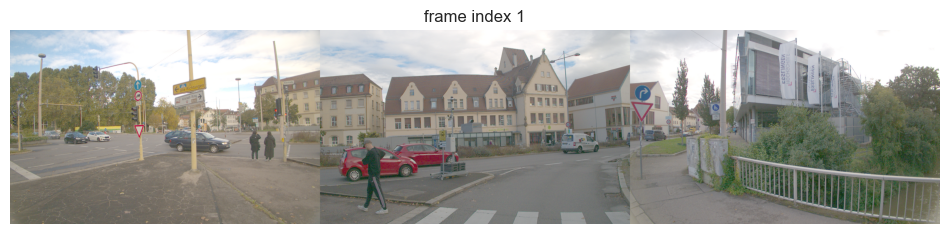

In [3]:
class VehicleCameraViewer():
    def __init__(self, frames):
        self.frames = frames
        self.frame_idx = 0
        self.vehicle_frame = self.frames[self.frame_idx].vehicle
        self.hcat_image = None

    def adjust_gamma(self, image, gamma=1.0):
        """ 
        Apply a gamma transformation to make the images look brighter. gamma=2.0 is a good value for this dataset. 
        """
        invGamma = 1.0 / gamma
        table = np.array([((i / 255.0) ** invGamma) * 255 for i in np.arange(0, 256)]).astype("uint8")
        return cv2.LUT(image, table)

    def next(self):
        self.frame_idx += 1
        self.vehicle_frame = self.frames[self.frame_idx].vehicle
        self.hcat_image = None

    def previous(self):
        self.frame_idx -= 1
        self.vehicle_frame = self.frames[self.frame_idx].vehicle
        self.hcat_image = None

    def jump(self, frame_idx):  
        """ 
        Jump to a specific frame index. 
        """
        self.frame_idx = frame_idx
        self.vehicle_frame = self.frames[self.frame_idx].vehicle
        self.hcat_image = None

    def show(self, frame_idx=None):
        """
        Show current camera frame or jump to a specific frame index and show it.
        """
        if frame_idx is not None:
            self.jump(frame_idx)

        if self.hcat_image is None:
            for camera in [self.vehicle_frame.cameras.FRONT_LEFT, self.vehicle_frame.cameras.STEREO_LEFT, self.vehicle_frame.cameras.FRONT_RIGHT]:
                resized_image = cv2.resize(np.array(camera._image_raw), (0, 0), fx=0.5, fy=0.5)
                if self.hcat_image is None:
                    self.hcat_image = resized_image
                else:
                    self.hcat_image = cv2.hconcat([self.hcat_image, resized_image])
            self.hcat_image = self.adjust_gamma(self.hcat_image, 2.0)

        plt.figure(figsize=(12, 5))
        plt.imshow(self.hcat_image)
        plt.axis('off')
        plt.title('frame index %d' % self.frame_idx);
        plt.show();


frame_idx = 1
vehicleCameraViewer = VehicleCameraViewer(frames)
vehicleCameraViewer.show(frame_idx=frame_idx)

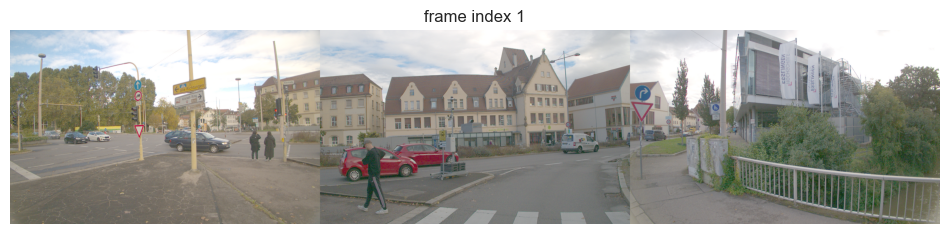

In [4]:
# Convert structured NumPy array to a regular 3D NumPy array with contiguous memory.
lidar_points = frames[frame_idx].vehicle.lidars.TOP
xyz_points = np.stack((lidar_points['x'], lidar_points['y'], lidar_points['z']), axis=-1)

def visualize_lidar_points(points, points_color=None, title="LiDAR Point Cloud", size=2, opacity=0.6):
    '''
    This function provides utility to visualize a pointcloud in jupyter notebooks. Outside of Jupyter Notebooks lidar pointclouds can also be visualized by simply calling:
    ad.show_points(lidar_points)
    '''
    if points_color is None:
        color = points[:, 2] - min(points[:, 2])
        color = color / max(color)
        marker_color = dict(
            size=size,
            color=color,
            colorscale='plasma',
            opacity=opacity
        )
    else:
        #this will be used later in the colab
        marker_color = dict(
            size=size,
            color=['rgb({}, {}, {})'.format(*rgb) for rgb in points_color],
            opacity=opacity
        )

    # Create a plotly 3D scatter plot
    fig = go.Figure(data=[go.Scatter3d(
        x=points[:, 0],
        y=points[:, 1],
        z=points[:, 2],
        mode='markers',
        marker=marker_color
    )])

    # Update the layout for better visualization
    fig.update_layout(
        scene=dict(
            xaxis_title='X',
            yaxis_title='Y',
            zaxis_title='Z',
            aspectmode='data'
        ),
        width=800,
        height=700,
        title=title
    )

    fig.show()

vehicleCameraViewer.show()
visualize_lidar_points(xyz_points, title='LiDAR Point Cloud')

## Basic data analysis

Analysis shows that there are many points (approx 30%) at position (0,0,0) and some points on the ego vehicle itself.
All of these should be removed lated.

In [5]:
df = pd.DataFrame(xyz_points, columns=['x', 'y', 'z'])
df.describe()

,x,y,z
count,131072.000000,131072.000000,131072.000000
mean,-0.885982,1.041256,0.397752
std,15.824658,12.665155,2.607154
min,-106.484467,-112.947433,-5.917768
25%,-0.172670,-0.044703,-0.134023
50%,0.000000,0.000000,0.000000
75%,0.254759,0.650585,0.000000
max,192.485519,118.986534,20.701454


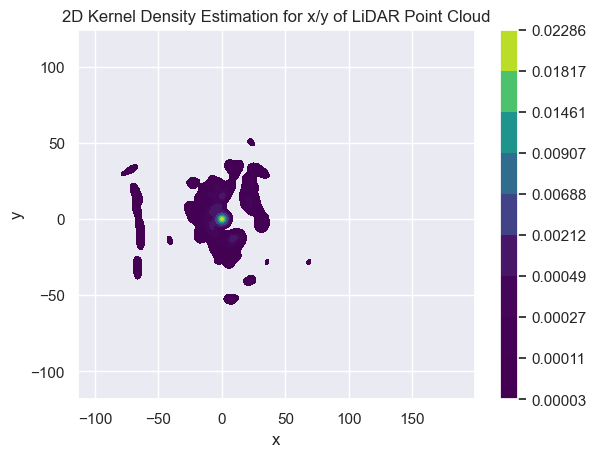

In [6]:
# This may take a while, so you may want to omit this.
sns.kdeplot(df, x='x', y='y', cmap='viridis', fill=True, cbar=True)
plt.title('2D Kernel Density Estimation for x/y of LiDAR Point Cloud');

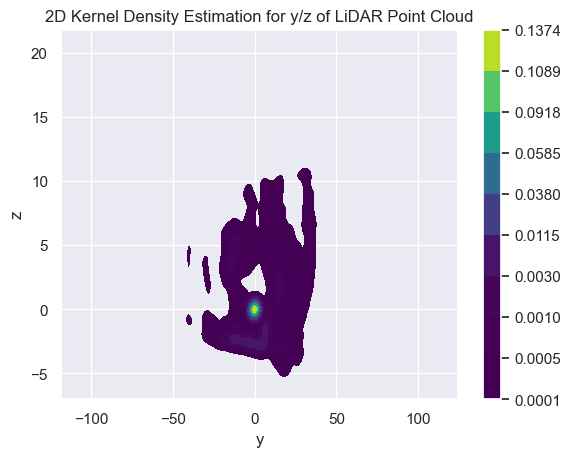

In [7]:
# This may take a while, so you may want to omit this.
sns.kdeplot(df, x='y', y='z', cmap='viridis', fill=True, cbar=True)
plt.title('2D Kernel Density Estimation for y/z of LiDAR Point Cloud');

## Remove irrelvant and errneous input points

We only care about valid points in a mid range around the ego vehicle.

Keeping points inside specified range (inverse=False).
Num. of remaining points: 108280 (of total 131072).
Non-zero-points:          51547 (of total 108280).
Non-NaN-points:           51547 (of total 51547).
Removing points outside specified range (inverse=True).
Num. of remaining points: 33278 (of total 51547).


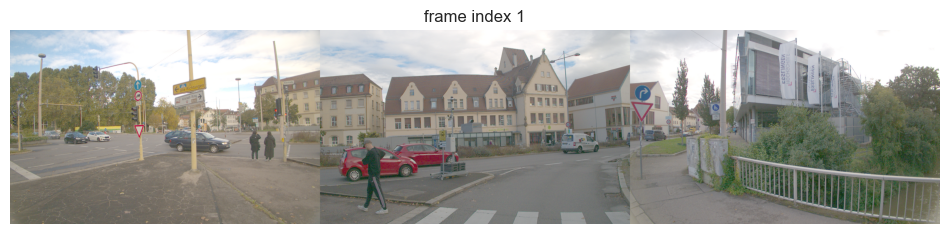

In [8]:
def getPointsInRange(points, x_range, y_range, z_range, inverse=False, verbose=True):
    x_min, x_max = x_range
    y_min, y_max = y_range
    z_min, z_max = z_range
    mask = (points[:, 0] >= x_min) & (points[:, 0] <= x_max) & (points[:, 1] >= y_min) & (points[:, 1] <= y_max) & (points[:, 2] >= z_min) & (points[:, 2] <= z_max)
    if inverse:
        mask = ~mask

    if verbose:
        if inverse:
            print('Removing points outside specified range (inverse=%r).' % inverse)
        else:
            print('Keeping points inside specified range (inverse=%r).' % inverse)
        print('Num. of remaining points: %d (of total %d).' % (np.sum(mask), len(mask)))

    return points[mask]

def removeZeros(pts, verbose=True):
    tol = 1e-2
    non_zero_pts = getPointsInRange(pts, (-tol, tol), (-tol, tol), (-tol, tol), inverse=True, verbose=False)
    if verbose:
        print('Non-zero-points:          %d (of total %d).' % (non_zero_pts.shape[0], pts.shape[0]))
    return non_zero_pts

def removeNaN(pts, verbose=True):
    non_nan_pts = pts[~np.isnan(pts).any(axis=1)]
    if verbose:
        print('Non-NaN-points:           %d (of total %d).' % (non_nan_pts.shape[0], pts.shape[0]))
    return non_nan_pts

# get non-zero points in the range of the vehicle
vehicle_points = getPointsInRange(xyz_points, (-30, 30), (-30, 30), (-4, 3))
vehicle_points = removeZeros(vehicle_points)
vehicle_points = removeNaN(vehicle_points)

# There are some points on the ego vehicle itself. Remove them.
vehicle_points = getPointsInRange(vehicle_points, (-1.2, 0.7), (-1.0, 1.0), (-0.5, 0.1), inverse=True)

vehicleCameraViewer.show()
fig = visualize_lidar_points(vehicle_points, title='LiDAR Point Cloud around the Vehicle')

## Model for fitting the ground plane

Points $(x_i, y_i, z_i)$ on a plane fulfill:
$$
a x_i + b y_i + c = z_i
$$
where 
$$
\mathbf{z} = \begin{pmatrix} a \\ b \\ c \end{pmatrix}
$$
is the state vector defining the ground plane.

This observation model can be used to find the ground plane via least squares regression. However, since our scene does not only contain points on the ground plane, we should implement a robust method as e.g. RANSAC as discussed in the lecture.

### A note on sampling

We will probably get bad results if we sample points three points from our point cloud that are very close to each other and then try to fit a plane through them.
So to improve our sampling strategym we will use a technique called "binning":

1. Partition all input data into euqally spaced bins, e.g. each of size 5mx5m in the x/y plane.
2. Then, randomly select three bins. From each of these bins, randomly draw on input point.

That way, we obtain samples for RANSAC that should have sufficient distance to enable a stable estimation of a plane through them.

This "binning" is implemented in the class below.

In [9]:
class BinSampler():
    """
    Partition the vehicle points into bins on the x/y-plane and sample from them.
    """
    def __init__(self, vehicle_points, num_bins=10):
        """
        Generate equally spaced bins on the x/y-plane and store the indices of the points in each bin.
        """
        ret = stats.binned_statistic_2d(vehicle_points[:,0], vehicle_points[:,1], vehicle_points[:,2], statistic='count', bins=num_bins)
        self.bins_with_indices = []
        for bin_nr in range(min(ret.binnumber), max(ret.binnumber)):
            mask = ret.binnumber == bin_nr
            if np.sum(mask) > 0:
                self.bins_with_indices.append(np.where(mask)[0])
        assert len(self.bins_with_indices) > 0, 'No non-empty bins found.'

    def sample(self, num_samples=3):
        """
        Randomly select different bins and sample one point from each bin.
        """
        assert num_samples <= len(self.bins_with_indices), 'Number of samples exceeds number of non-empty bins.'
        idx = []
        bin_indices = np.random.choice(len(self.bins_with_indices), num_samples, replace=False)
        for bin_idx in bin_indices:
            idx.append(self.bins_with_indices[bin_idx][np.random.choice(len(self.bins_with_indices[bin_idx]), 1)[0]])
        return idx

### Robust LS estimate

Now we are ready to compute the robust LS estimate. 
Note how we get inferior results if we use a standard LS estimator without random sampling.

z_hat: [[ 0.01730024]
 [-0.01736451]
 [-2.56990486]]
med_res: 0.5438573868809371


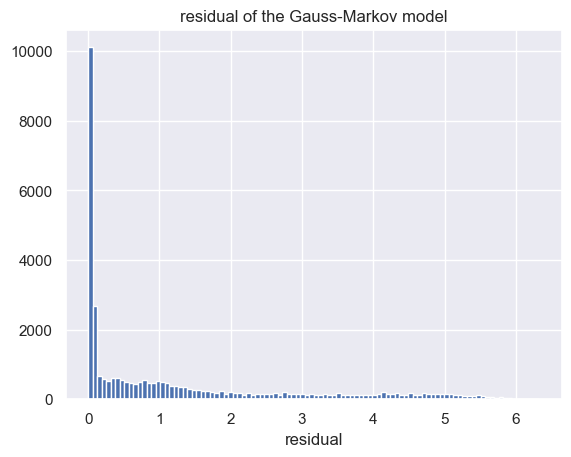

In [10]:
def GaussMarkovModel(pts):
    assert pts.shape[1] == 3, 'input should be Nx3 matrix'
    N = pts.shape[0]

    H = np.zeros((N, 3))
    H[:,:2] = pts[:,:2]
    H[:,2] = 1

    y_hat = np.zeros((N, 1))
    y_hat[:,0] = pts[:,2]

    return H, y_hat

def computeResidual(pts, z_hat):
    H, y_hat = GaussMarkovModel(pts)
    res = np.dot(H, z_hat) - y_hat
    return res

def ransac(pts, num_iter=50, inlier_threshold=0.1):
    best_inliers = []
    best_z_hat = None
    best_med_res = np.inf

    binSampler = BinSampler(pts)

    for _ in range(num_iter):
        #idx = np.random.choice(pts.shape[0], 3, replace=False)
        idx = binSampler.sample(num_samples=3)

        H, y_hat = GaussMarkovModel(pts[idx,:])
        z_hat = np.dot(np.linalg.pinv(H), y_hat)
        res = computeResidual(pts, z_hat)
        med_res = np.median(np.abs(res))
        inliers = np.where(np.abs(res) < inlier_threshold)[0]

        #if med_res < best_med_res: # for LMedS
        if len(inliers) > len(best_inliers): # for standard RANSAC
            best_inliers = inliers
            best_z_hat = z_hat
            best_med_res = med_res

    return best_z_hat, best_med_res, best_inliers


mode = 'ransac'
if mode in ['all']:
    H, y_hat = GaussMarkovModel(vehicle_points[:,:])
    z_hat = np.dot(np.linalg.pinv(H), y_hat)
else: # 'ransac'
    z_hat, med_res, inliers = ransac(vehicle_points[:,:], num_iter=1000, inlier_threshold=0.05)

res = computeResidual(vehicle_points[:,:], z_hat)
med_res = np.median(np.abs(res))

#print('H:', H)
#print('y_hat:', y_hat)
print('z_hat:', z_hat)
#print('res:', res)
print('med_res:', med_res)

plt.figure()
plt.hist(np.abs(res), bins=100) 
plt.xlabel('residual')
plt.title('residual of the Gauss-Markov model');


Ground points: 13035 (of total 33278).


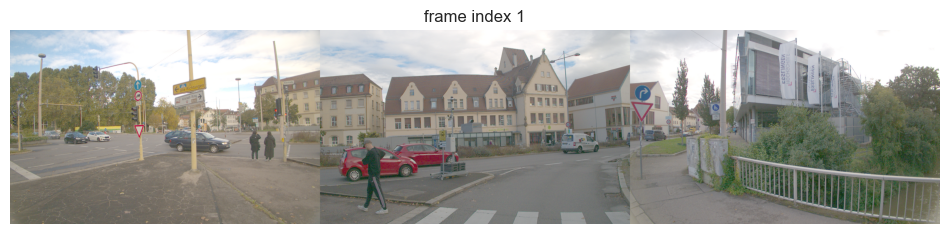

In [11]:
ground_mask = np.abs(res) < 0.15
ground_mask = ground_mask.ravel()
print('Ground points: %d (of total %d).' % (np.sum(ground_mask), len(ground_mask)))

vehicle_points_no_ground = vehicle_points[~ground_mask]

vehicleCameraViewer.show()
fig = visualize_lidar_points(vehicle_points_no_ground, title='LiDAR Point Cloud (ground removed)')

## Being more precise: Total Least Squares

Above, the error was confied to the z-direction only. This is sufficient here since the plane is approximately orthogonal to the z-axis, but in general, we can do better with a method called "Total Least Squares" estimation.

First, note that for computing a metric distance, we can convert the equation above to a Hessian normal form (cf [Wikipedia](https://de.wikipedia.org/wiki/Hessesche_Normalform)):
$$
\left( -a, -b, 1 \right) \begin{pmatrix} x_i \\ y_i \\ z_i \end{pmatrix} = c
$$
and - with apropriate normalization - get a formula for the metric distance:
$$
d = \frac{\left( -a, -b, 1 \right) \begin{pmatrix} x_i \\ y_i \\ z_i \end{pmatrix} - c}{\sqrt{a^2 + b^2 + 1}} 
$$

(In our case, since the normal vector of the ground plane and the z-axis are almost parallel, the difference between the metric distance and the residuals is not very significant.)

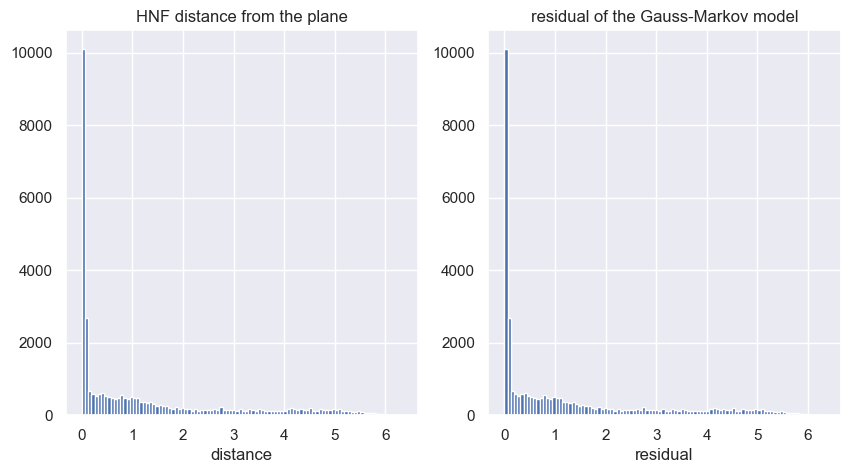

In [12]:
def HNF_distance(pts, z_hat):
    a, b, c = z_hat[0].item(), z_hat[1].item(), z_hat[2].item()
    n = np.array([-a, -b, 1])
    n_norm = np.linalg.norm(n)
    dist = ( c - np.dot(n, np.transpose(pts)) ) / n_norm
    return dist

dist = HNF_distance(vehicle_points[:,:], z_hat)
med_res = np.median(np.abs(res))

plt.figure(figsize=(10, 5))
plt.subplot(1,2,1)
plt.hist(np.abs(dist), bins=100) 
plt.xlabel('distance')
plt.title('HNF distance from the plane');

plt.subplot(1,2,2)
plt.hist(np.abs(res), bins=100) 
plt.xlabel('residual')
plt.title('residual of the Gauss-Markov model');

Let's now compute the total least square estimate of the plane using all LiDAR points that have been marked as inliers running the previous RANSAC estimation. More info on how TLS works can be found [here](https://www.researchgate.net/publication/2139664_An_Introduction_to_Total_Least_Squares)
and in this [stackoverflow answer by Michael Litvin](https://stackoverflow.com/questions/1400213/3d-least-squares-plane).

n: [-0.0175505  0.0176763  0.9996897]
center: [-6.6838365 -6.6948276 -2.5717108]


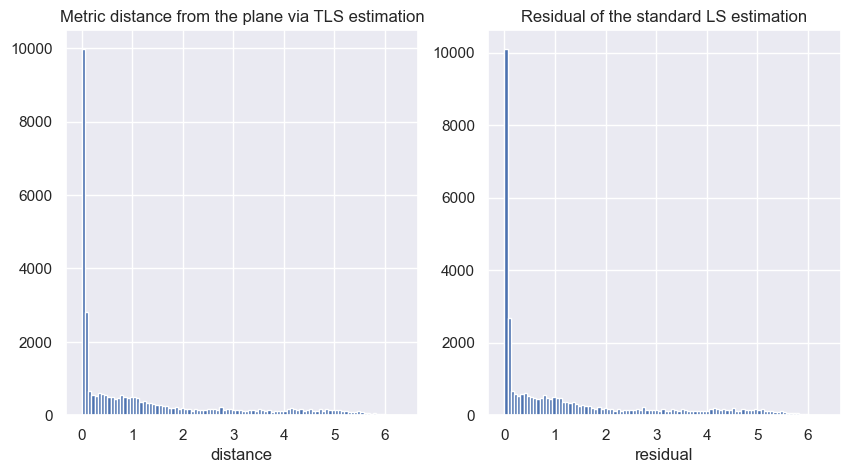

In [13]:
def TLS(pts):
    """
    Use total least squares to compute a plane that 
    - passes through the center of the given data points and 
    - has normal vector n
    """ 
    center = np.mean(pts, axis=0)
    M = pts - center 
    MTM = np.dot(np.transpose(M), M)
    U, S, Vt = np.linalg.svd(MTM) 
    n = Vt[-1] # eigenvector corresponding to the least eigenvalue
    return n, center

# Run total least squares estimation on all RANSAC inliers
n, center = TLS(vehicle_points[inliers, :])
print('n:', n)
print('center:', center)

# Compute the distance of all points to the TLS plane
dist_TLS = np.dot(n, np.transpose(vehicle_points-center)) 

plt.figure(figsize=(10, 5))
plt.subplot(1,2,1)
plt.hist(np.abs(dist_TLS), bins=100) 
plt.xlabel('distance')
plt.title('Metric distance from the plane via TLS estimation');

plt.subplot(1,2,2)
plt.hist(np.abs(res), bins=100) 
plt.xlabel('residual')
plt.title('Residual of the standard LS estimation');

Ground points: 13046 (of total 33278).


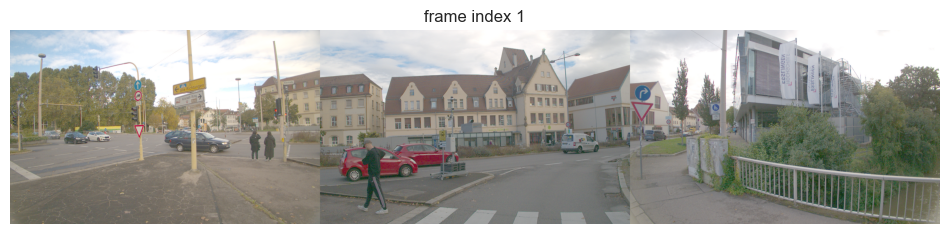

In [14]:
ground_mask = np.abs(dist_TLS) < 0.15
ground_mask = ground_mask.ravel()
print('Ground points: %d (of total %d).' % (np.sum(ground_mask), len(ground_mask)))

vehicle_points_no_ground = vehicle_points[~ground_mask]

vehicleCameraViewer.show()
fig = visualize_lidar_points(vehicle_points_no_ground, title='LiDAR Point Cloud (ground removed with TLS on all inliers)')